# The Sparks Foundation (GRIP, Data Science and Business Analytics)
## Task 4: Exploratory Data Analysis - Terrorism

#### Problem Statement:
i) As a security/defense analyst, finding the hot zone of terrorists <br>
ii) Deriving all the security issues and further insights


#### Dataset Used:
'https://bit.ly/2TK5Xn5' (Global terrorism Dataset)

In [1]:
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
from collections import Counter
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import MarkerCluster

In [2]:
data=pd.read_csv('globalterrorismdb_0718dist.csv', encoding='latin1')
data.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [3]:
pd.set_option('display.max_rows',200)
data.isnull().sum()

eventid                    0
iyear                      0
imonth                     0
iday                       0
approxdate            172452
extended                   0
resolution            179471
country                    0
country_txt                0
region                     0
region_txt                 0
provstate                421
city                     434
latitude                4556
longitude               4557
specificity                6
vicinity                   0
location              126196
summary                66129
crit1                      0
crit2                      0
crit3                      0
doubtterr                  1
alternative           152680
alternative_txt       152680
multiple                   1
success                    0
suicide                    0
attacktype1                0
attacktype1_txt            0
attacktype2           175377
attacktype2_txt       175377
attacktype3           181263
attacktype3_txt       181263
targtype1     

In [4]:
data=data[['iyear','imonth','iday','country_txt','region_txt','provstate','city',
           'latitude','longitude','location','summary','attacktype1_txt','targtype1_txt',
           'target1','gname','motive','weaptype1_txt','weapdetail','nkill','nwound','propextent_txt','ransom']]
data.rename(columns={
    'country_txt':'country', 'region_txt':'region', 'provstate':'state', 'attacktype1_txt':'attacktype',
    'targtype1_txt':'targettype', 'target1':'target', 'weaptype1_txt':'weapon','propextent_txt':'damage'
},inplace=True)
data.head()

,iyear,imonth,iday,country,region,state,city,latitude,longitude,location,...,targettype,target,gname,motive,weapon,weapdetail,nkill,nwound,damage,ransom
0,1970,7,2,Dominican Republic,Central America & Caribbean,NaN,Santo Domingo,18.456792,-69.951164,NaN,...,Private Citizens & Property,Julio Guzman,MANO-D,NaN,Unknown,NaN,1.0,0.0,NaN,0.0
1,1970,0,0,Mexico,North America,Federal,Mexico city,19.371887,-99.086624,NaN,...,Government (Diplomatic),"Nadine Chaval, daughter",23rd of September Communist League,NaN,Unknown,NaN,0.0,0.0,NaN,1.0
2,1970,1,0,Philippines,Southeast Asia,Tarlac,Unknown,15.478598,120.599741,NaN,...,Journalists & Media,Employee,Unknown,NaN,Unknown,NaN,1.0,0.0,NaN,0.0
3,1970,1,0,Greece,Western Europe,Attica,Athens,37.997490,23.762728,NaN,...,Government (Diplomatic),U.S. Embassy,Unknown,NaN,Explosives,Explosive,NaN,NaN,NaN,0.0
4,1970,1,0,Japan,East Asia,Fukouka,Fukouka,33.580412,130.396361,NaN,...,Government (Diplomatic),U.S. Consulate,Unknown,NaN,Incendiary,Incendiary,NaN,NaN,NaN,0.0


### Data Understanding

- iyear - year in which the incident happened
- imonth - month in which the incident happened
- iday - day at which the incident happened
- country - country in which the incident happened
- region - region in which the incident happened
- state - state in which the incident happened
- city - city name in which the incident happened
- latitude - latitude value of the place of incident
- longitude - longitude value of the place of incident
- location - Exact location or place which was targetted for the attack to happen
- summary - a little summary about events that took place in the attack
- attacktype - how did the attack took place
- targettype - understanding about the type of target
- target - Name or details about the target
- gname - name of the group responsible for causing the incident
- motive - possible motive behind the attack 
- weapon - type of weapon used for attack
- weapdetail - further details about the weapon
- nkill - number of people killed
- nwound - number of people wounded
- damage - covers the extent of the property damage (minor(< $1 million) or major(>= $1 million but < $1 billion))
- ransom - classified into if ransom was asked or not (0 and 1 values)

In [5]:
data.shape

(181691, 22)

In [6]:
data['nkill']=data['nkill'].fillna(0)
data['nwound']=data['nwound'].fillna(0)

In [7]:
data.isnull().sum()

iyear              0
imonth             0
iday               0
country            0
region             0
state            421
city             434
latitude        4556
longitude       4557
location      126196
summary        66129
attacktype         0
targettype         0
target           636
gname              0
motive        131130
weapon             0
weapdetail     67670
nkill              0
nwound             0
damage        117626
ransom        104310
dtype: int64

In [8]:
yearwise_region=pd.crosstab(data.iyear,data.region)
#yearwise_region=pd.pivot_table(data=data,index='iyear',columns='region')
yearwise_region

region,Australasia & Oceania,Central America & Caribbean,Central Asia,East Asia,Eastern Europe,Middle East & North Africa,North America,South America,South Asia,Southeast Asia,Sub-Saharan Africa,Western Europe
iyear,,,,,,,,,,,,
1970,1,7,0,2,12,28,472,65,1,10,3,50
1971,1,5,0,1,5,55,247,24,0,6,2,125
1972,8,3,0,0,1,53,73,33,1,16,4,376
1973,1,6,0,2,1,19,64,83,1,2,4,290
1974,1,11,0,4,2,42,111,81,2,3,7,317
1975,0,9,0,12,0,44,159,55,4,7,12,438
1976,0,45,0,2,0,55,125,91,4,12,11,578
1977,0,24,0,4,2,211,149,119,2,8,29,771
1978,2,199,0,35,2,128,117,222,2,44,46,729


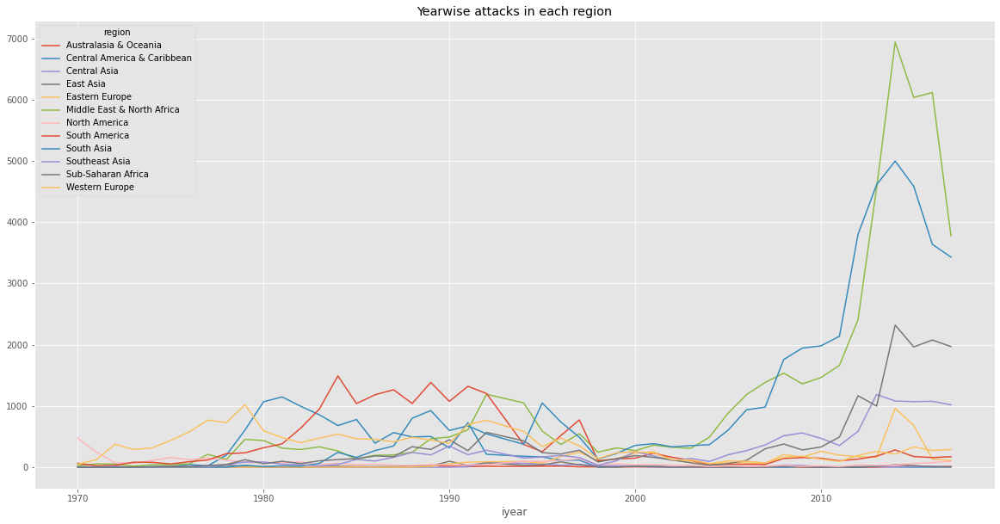

In [9]:
plt.style.use('ggplot')
yearwise_region.plot(figsize=(20,10))
plt.title('Yearwise attacks in each region')
plt.show()

#### Here it can be seen that,
- between 1990 and 2000 there was a drop in terror attacks in all regions
- In 2014, there was a peak in terror attacks
- Most number of attacks were in the Middle East and North Africa region

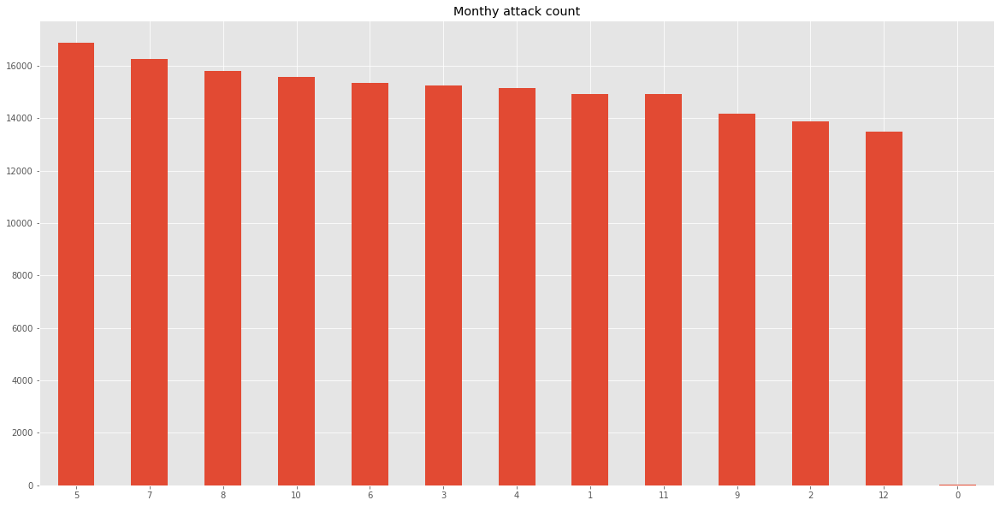

In [10]:
data['imonth'].value_counts().plot.bar(rot=False,figsize=(20,10))
plt.title('Monthy attack count')
plt.show()

- The month of May followed by July had the most number of terror attacks

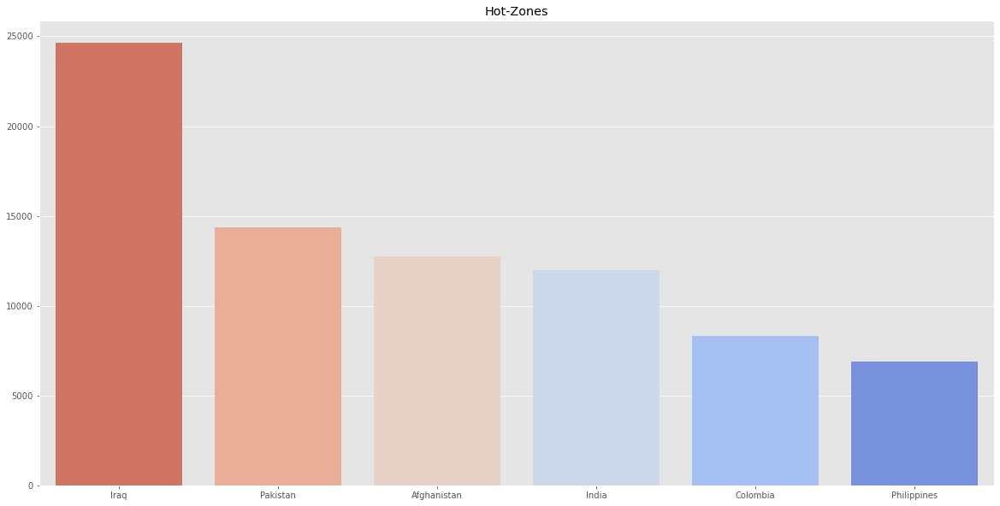

In [11]:
plt.figure(figsize=(20,10))
hot_zones=data.country.value_counts()[:6]
sns.barplot(hot_zones.index,hot_zones.values,palette='coolwarm_r')
plt.title('Hot-Zones')
plt.show()

#### This graph shows us the top hot zone countries of the attack
The most hot zone country being Iraq, where maximum number of attacks have happened

In [12]:
year_2014=data[data['iyear']==2014]
tomark=year_2014.loc[:,'city':'longitude']
tomark=tomark.dropna().values.tolist()

mapp=folium.Map([0,50],zoom_start=2)
cluster=MarkerCluster().add_to(mapp)
for point in range(len(tomark)):
    folium.Marker(location=[tomark[point][1],tomark[point][2]],popup=tomark[point][0]).add_to(cluster)
mapp

#### The showed map tells the citywise hotzones in the year with maximum attacks i.e., 2014

In [13]:
country_kill=data[['country','nkill']].groupby(
    ['country'],axis=0).sum().sort_values(
    'nkill',ascending=False).reset_index().head(10)
country_kill

,country,nkill
0,Iraq,78589.0
1,Afghanistan,39384.0
2,Pakistan,23822.0
3,Nigeria,22682.0
4,India,19341.0
5,Sri Lanka,15530.0
6,Syria,15229.0
7,Colombia,14698.0
8,Peru,12771.0
9,El Salvador,12053.0


#### Here it can be seen that, maximum number of deaths have also happened in Iraq, followed by Afghanistan and then Pakistan

In [14]:
#group_kill_data=data[['gname','nkill','country','latitude','longitude']].groupby(['gname'],axis=0).sum().drop('Unknown').sort_values('nkill',ascending=False).head(10)
attacktype_data=data[['attacktype','nkill','nwound']].groupby(["attacktype"],axis=0).sum().sort_values('nkill',ascending=False).drop('Unknown')
attacktype_data

,nkill,nwound
attacktype,,
Armed Assault,160297.0,77366.0
Bombing/Explosion,157321.0,372686.0
Assassination,24920.0,13887.0
Hostage Taking (Kidnapping),24231.0,6446.0
Hostage Taking (Barricade Incident),4478.0,3966.0
Hijacking,3718.0,17001.0
Facility/Infrastructure Attack,3642.0,3765.0
Unarmed Assault,880.0,14027.0


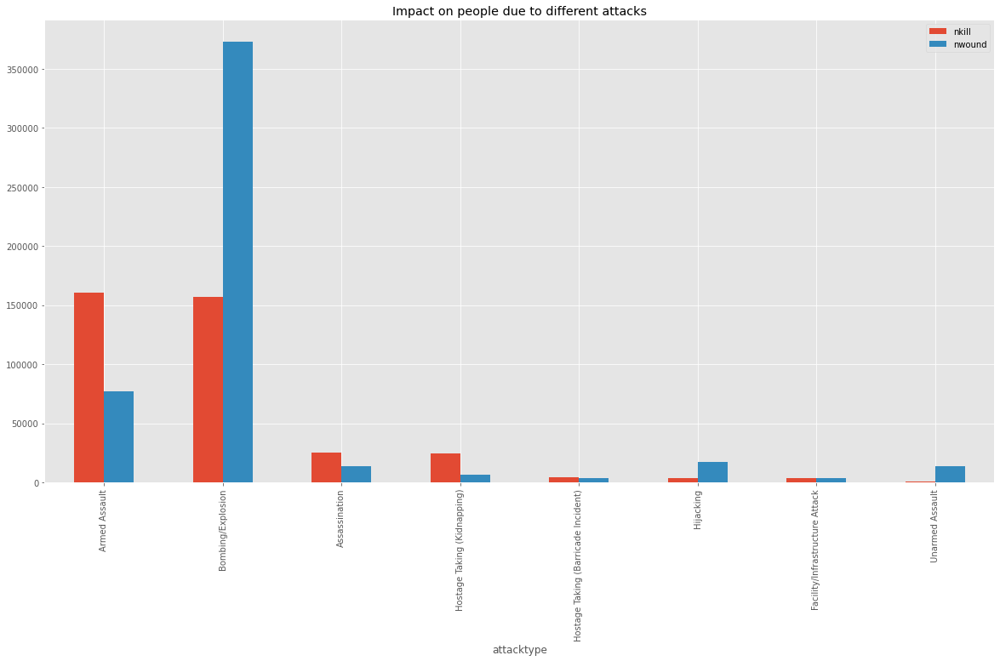

In [15]:
#plt.style.use('ggplot')
attacktype_data.plot.bar(figsize=(20,10))
plt.title('Impact on people due to different attacks')
plt.show()

#### Here, Armed Assault and Bombing/Explosion have come out to have the maximum impact on the people
- Armed Assault has the maximum number of deaths followed by Bombing/Explosion
- Bombing/Explosion has the maximum number of people wounded

In [16]:
armed_attack=data[data['attacktype']=='Armed Assault'].dropna()
bombing=data[data['attacktype']=='Bombing/Explosion'].dropna()
assassination=data[data['attacktype']=='Assassination'].dropna()

In [17]:
armed_attack[['latitude','longitude']].describe()

,latitude,longitude
count,196.000000,196.000000
mean,27.787706,18.451038
std,13.171479,51.249972
min,-3.375828,-122.392934
25%,21.772604,2.583559
50%,34.951863,6.811558
75%,36.559769,45.345592
max,47.657130,125.647026


In [18]:
map = folium.Map(location=[27.78,18.45], zoom_start=2)

def marking_map(data,feature,icon,color):
    map_feature=folium.FeatureGroup(name=feature)
    locations = data[['latitude', 'longitude']]
    locationlist = locations.values.tolist()
    n=len(locationlist)
    for point in range(n):
        folium.Marker(locationlist[point],icon=folium.Icon(icon=icon,color=color)).add_to(map_feature)
    return map_feature

map1=marking_map(armed_attack,'Areas with armed attack','glyphicon-warning-sign','orange')
map2=marking_map(bombing,'Areas with bombing/explosion','glyphicon-fire','red')
map3=marking_map(assassination,'assassination','glyphicon-screenshot','blue')

map.add_child(map1)
map.add_child(map2)
map.add_child(map3)
map.add_child(folium.map.LayerControl())
map

#### The showed map tell us the location of the countries who faced 
- Armed Assault (Orange markers)
- Bombing/Explosion (Red markers)
- Assassination (Blue markers)

In [19]:
major_location=pd.DataFrame(data[['location','country']].value_counts()).head(10)
major_location=major_location.rename(columns={0:'count'})
major_location

,,count
location,country,
"The attack took place in Baghdad, Baghdad, Iraq.",Iraq,142
Belfast (Capital City),United Kingdom,98
The incident occurred at the Donetsk Sergey Prokofiev International Airport.,Ukraine,62
Manhattan,United States,60
"The attack took place in Mosul, Ninawa, Iraq.",Iraq,51
The incident occurred in the Balad Ruz district.,Iraq,48
The incident occurred in the Shaab area of Adhamiyah neighborhood,Iraq,40
The incident occurred in the Al-Faris district.,Iraq,39
"The attack took place in Kirkuk, At Ta'mim, Iraq.",Iraq,39


<AxesSubplot:xlabel='Target type'>

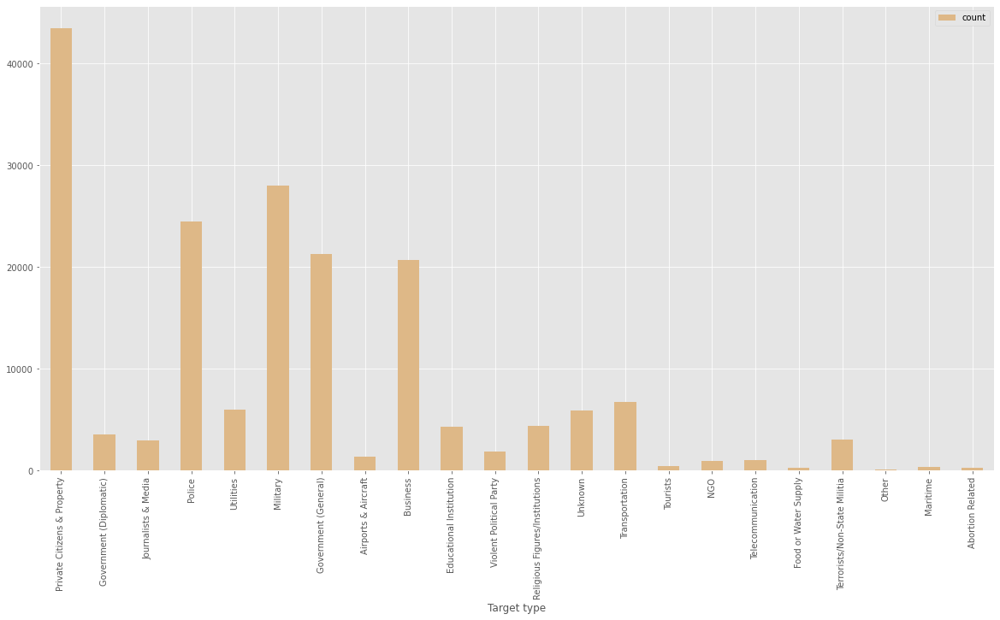

In [20]:
target=pd.DataFrame(dict(Counter(list(data['targettype'].dropna()))).items())
target=target.rename(columns={0:'Target type',1:'count'})
target.plot.bar(x='Target type',color='burlywood',figsize=(20,10))

#### The displayed analysis tells the major groups which were targetted for the attack, top 5 being,
1. Private Citizens & Property
2. Military 
3. Police
4. Government (General)
5. Business

<AxesSubplot:>

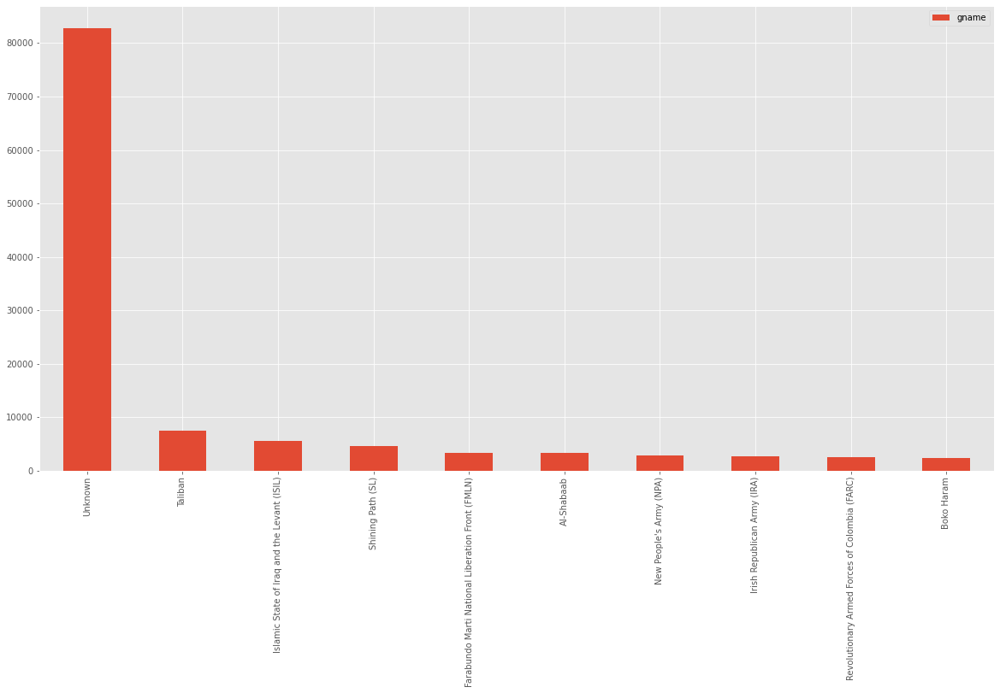

In [21]:
data['gname'].value_counts().to_frame().head(10).plot.bar(figsize=(20,10))

#### The major Terror Groups which were responsible behind the attacks were,
1. Unknown
2. Taliban
3. Islamic State of Iraq and the Levant (ISIL)	
4. Shining Path (SL)	

In [22]:
group_kill=data[['gname','country','nkill']].groupby(
    ['gname','country'],axis=0).sum().sort_values(
    'nkill',ascending=False).drop('Unknown').reset_index().head(10)
group_kill

,gname,country,nkill
0,Islamic State of Iraq and the Levant (ISIL),Iraq,31058.0
1,Taliban,Afghanistan,29269.0
2,Boko Haram,Nigeria,16917.0
3,Shining Path (SL),Peru,11595.0
4,Liberation Tigers of Tamil Eelam (LTTE),Sri Lanka,10928.0
5,Al-Shabaab,Somalia,8176.0
6,Farabundo Marti National Liberation Front (FMLN),El Salvador,8019.0
7,Islamic State of Iraq and the Levant (ISIL),Syria,6883.0
8,Nicaraguan Democratic Force (FDN),Nicaragua,6630.0
9,Tehrik-i-Taliban Pakistan (TTP),Pakistan,6014.0


In [23]:
data['summary'].value_counts().to_frame().head(10)

,summary
"09/00/2016: Sometime between September 18, 2016 and September 24, 2016, assailants detonated an explosive device at a civilian house in Dawr, Saladin, Iraq. There were no reported casualties resulting from the blast. No group claimed responsibility for the incident; however, sources attributed the attack to the Islamic State of Iraq and the Levant (ISIL).",100
"12/01/2016: Assailants detonated explosive devices that destroyed an electricity transmission tower in Albu Bali, Al Anbar, Iraq. This was one of 80 similar attacks targeting towers that resulted in the death of two military engineering team members. No group claimed responsibility for the incidents.",80
"05/29/2016: Security forces discovered and defused an explosives-rigged house in Sejar, Al Anbar, Iraq. No group claimed responsibility for the incident.",50
"01/11/2016: Assailants set fire to a shop in Muqdadiyah, Diyala governorate, Iraq. There were no reported casualties in the incident. This was one of 36 shops set alight and one of 51 attacks in and around Muqdadiyah on the same day. No group claimed responsibility; however, sources attributed the incidents to Asa'ib Ahl al-Haqq and the Badr Brigades.",36
"07/22/2016: Security forces discovered and defused an explosives-rigged house in Saqlawiyah, Al Anbar, Iraq. No group claimed responsibility for the incident.",36
"04/21/2017: Security forces discovered and defused an explosives-rigged house in Hayy ath-Thawrah neighborhood, Mosul, Nineveh, Iraq. This was one of 34 similar events in the area on this date. No group claimed responsibility for the incident.",34
"08/08/2016: Security forces discovered and defused an explosives-rigged house in Khalidiyah, Al Anbar, Iraq. No group claimed responsibility for the incident.",30
"06/05/2016: Security forces discovered and defused an explosives-rigged house in Rutbah, Al Anbar, Iraq. No group claimed responsibility for the incident.",30
"07/00/2014: Sometime between July 1 and July 14, 2014, an explosive device detonated at a private residence in Azim area, Diyala governorate, Iraq. There were no reported casualties; however, the house was damaged in the blast. This was one of 27 similar attacks on private residences in this area over a two week period. No group claimed responsibility for the incident; however, sources attributed the attack the to the Islamic State of Iraq and the Levant (ISIL).",27
"10/23/2016: Security forces discovered and defused an explosives-rigged house in Dulab, Al Anbar, Iraq. No group claimed responsibility for the incident.",27


## Conclusions

- There has been a major increase in the attacks after 2010 which calls for a serious actions and security advancements like tightening of borders,  or further make the laws stricter
- All the countries should come out together in fighting the problem of terrorism
- The Hot-zone of the attacks is Middle East and North Aftrica followed by South Asia, so those regions must have the maximum focus
- Iraq, Afganistan and Pakistan have suffered the most due to these attacks and have lost the maximum number of citizens
- Considering overall impact on citizens, Bombing and explosives have come out to have the maximum impact followed by Armed Assault. So Security measures must be enhanved in order to cope up with the damage caused by such attacks
- The groups behind major attacks are still unknown. Out of the known, Taliban and Islamic State of Iraq and the Levant (ISIL) groups have organised most of the attacks.
- And mainly Private citizens, Military and police is being targeted 